# Variational classification

In this page, we introduce variational algorithms, then describe and implement variational quantum [classifier](gloss:classifier) and discuss variational training. 

## Variational algorithms

Variational algorithms were introduced in 2014, with the variational [eigensolver](gloss:eigensolver) in Reference 1 and the quantum approximate optimization algorithm in Reference 2. A variational algorithm is a [near-term algorithm](gloss:near-term-algorithm) that can be executed on current quantum computers in concert with classical computers. 

Using a parameterized quantum circuit, or ansatz, $U(\theta)$, we prepare a state $|\psi(\theta) \rangle = U(\theta) |0 \rangle$, and measure the expectation value using a quantum computer. We define a cost function $C(\theta)$, that determines how good $\theta$ is for the problem we are trying to solve. We then use a classical computer to calculate the cost function and provide updated circuit parameters using an optimization algorithm. The goal of the algorithm is to find the circuit parameters $\theta$ for the parameterized quantum circuit $U(\theta)$ that minimizes the cost function $C(\theta)$. 

![](images/vqc/va.svg)

## The variational quantum classifier

The variational quantum classifier is a variational algorithm where the measured expectation value is interpreted as the output of a classifier, introduced by multiple groups in 2018. For a binary classification problem, with input data vectors $\vec{x}_i$ and binary output labels $y_i = \{0,1\}$; for each input data vector, we build a parameterized quantum circuit that outputs the quantum state:

$$ \cssId{_eq_1}{|\psi(\vec{x}_i;\vec{\theta}) \rangle =  U_{W(\vec{\theta})}U_{\phi(\vec{x}_i)}|0 \rangle}$$

where $U_{W(\vec{\theta})}$ corresponds to the variational circuit unitary and $U_{\phi(\vec{x}_i)}$ corresponds to the data encoding circuit unitary. After creating and measuring the circuit of $n$ qubits, we're left with a $n$ length bitstring from which we must derive the binary output which will be our classification result. This is done with the help of a Boolean function $ \cssId{_map_1}{ f: \{0, 1\}^{n} \rightarrow \{0, 1\} }$. The [parity function](gloss:parity-function) is a popular choice for this.

![](images/vqc/vqc.svg)

In the training phase, we're trying to find the values for $\vec{\theta}$ that give us the best predictions. The classical computer compares the predicted labels $\hat{y_i}$, to the provided labels $y_i$, and we calculate the success of our predictions using a cost function. Based on this cost, the classical computer chooses another value for $\vec{\theta}$ using a classical optimization algorithm. This new $\vec{\theta}$ is then used to run a new circuit, and the process is repeated until the cost function stabilizes.

### Full implementation

Let's implement all the separate components of the variational quantum classifier, and classify the `adhoc` dataset, as described in Reference 3, following [this implementation](https://github.com/0x6f736f646f/variational-quantum-classifier-on-heartattack/blob/main/Src/Notebooks/02-qiskit.ipynb) from [Rodney Osodo](https://medium.com/qiskit/building-a-quantum-variational-classifier-using-real-world-data-809c59eb17c2).

1. We create 20 training data points and 5 testing data points of 2 features from each class.

In [25]:
import pandas as pd
import numpy as np

In [44]:
df=pd.read_csv('pre_processed_data/df_x.csv')
features=df.iloc[:,:].values

In [46]:
df_1=pd.read_csv('pre_processed_data/df_y.csv')
labels=df_1.iloc[:,:].values

In [49]:
from qiskit.utils import algorithm_globals
algorithm_globals.random_seed = 3142
from sklearn.model_selection import train_test_split
from qiskit_algorithms.utils import algorithm_globals

import numpy as np
np.random.seed(algorithm_globals.random_seed)

from qiskit_machine_learning.datasets import ad_hoc_data
# pylint: disable=unbalanced-tuple-unpacking
TRAIN_DATA, TRAIN_LABELS, TEST_DATA, TEST_LABELS = TRAIN_DATA, TRAIN_LABELS, TEST_DATA, TEST_LABELS = train_test_split(
    features, labels, train_size=0.8, random_state=algorithm_globals.random_seed
)
# pylint: enable=unbalanced-tuple-unpacking

2. We prepare the classification circuit, using the Qiskit `ZZFeatureMap` as the data encoding circuit, and the Qiskit `TwoLocal` circuit with $Y$ and $Z$ rotations and controlled-phase gates, as the variational circuit, as per Reference 3.

In [50]:
from qiskit.circuit.library import ZZFeatureMap, TwoLocal
FEATURE_MAP = ZZFeatureMap(feature_dimension=52, reps=2)
VAR_FORM = TwoLocal(2, ['ry', 'rz'], 'cz', reps=2)

AD_HOC_CIRCUIT = FEATURE_MAP.compose(VAR_FORM)
AD_HOC_CIRCUIT.measure_all()
AD_HOC_CIRCUIT.decompose().draw()

┌───┐┌─────────────┐                                                »
    q_0: ┤ H ├┤ P(2.0*x[0]) ├───■────────────────────────────────────■────■──»
         ├───┤├─────────────┤ ┌─┴─┐┌──────────────────────────────┐┌─┴─┐  │  »
    q_1: ┤ H ├┤ P(2.0*x[1]) ├─┤ X ├┤ P(2.0*(π - x[0])*(π - x[1])) ├┤ X ├──┼──»
         ├───┤├─────────────┤ └───┘└──────────────────────────────┘└───┘┌─┴─┐»
    q_2: ┤ H ├┤ P(2.0*x[2]) ├───────────────────────────────────────────┤ X ├»
         ├───┤├─────────────┤                                           └───┘»
    q_3: ┤ H ├┤ P(2.0*x[3]) ├────────────────────────────────────────────────»
         ├───┤├─────────────┤                                                »
    q_4: ┤ H ├┤ P(2.0*x[4]) ├────────────────────────────────────────────────»
         ├───┤├─────────────┤                                                »
    q_5: ┤ H ├┤ P(2.0*x[5]) ├────────────────────────────────────────────────»
         ├───┤├─────────────┤                                                »
    q_6: ┤ H ├┤ P(2.0*x[6]) ├────────────────────────────────────────────────»
         ├───┤├─────────────┤                                                »
    q_7: ┤ H ├┤ P(2.0*x[7]) ├────────────────────────────────────────────────»
         ├───┤├─────────────┤                                                »
    q_8: ┤ H ├┤ P(2.0*x[8]) ├────────────────────────────────────────────────»
         ├───┤├─────────────┤                                                »
    q_9: ┤ H ├┤ P(2.0*x[9]) ├────────────────────────────────────────────────»
         ├───┤├─────────────┴┐                                               »
   q_10: ┤ H ├┤ P(2.0*x[10]) ├───────────────────────────────────────────────»
         ├───┤├──────────────┤                                               »
   q_11: ┤ H ├┤ P(2.0*x[11]) ├───────────────────────────────────────────────»
         ├───┤├──────────────┤                                               »
   q_12: ┤ H ├┤ P(2.0*x[12]) ├───────────────────────────────────────────────»
         ├───┤├──────────────┤                                               »
   q_13: ┤ H ├┤ P(2.0*x[13]) ├───────────────────────────────────────────────»
         ├───┤├──────────────┤                                               »
   q_14: ┤ H ├┤ P(2.0*x[14]) ├───────────────────────────────────────────────»
         ├───┤├──────────────┤                                               »
   q_15: ┤ H ├┤ P(2.0*x[15]) ├───────────────────────────────────────────────»
         ├───┤├──────────────┤                                               »
   q_16: ┤ H ├┤ P(2.0*x[16]) ├───────────────────────────────────────────────»
         ├───┤├──────────────┤                                               »
   q_17: ┤ H ├┤ P(2.0*x[17]) ├───────────────────────────────────────────────»
         ├───┤├──────────────┤                                               »
   q_18: ┤ H ├┤ P(2.0*x[18]) ├───────────────────────────────────────────────»
         ├───┤├──────────────┤                                               »
   q_19: ┤ H ├┤ P(2.0*x[19]) ├───────────────────────────────────────────────»
         ├───┤├──────────────┤                                               »
   q_20: ┤ H ├┤ P(2.0*x[20]) ├───────────────────────────────────────────────»
         ├───┤├──────────────┤                                               »
   q_21: ┤ H ├┤ P(2.0*x[21]) ├───────────────────────────────────────────────»
         ├───┤├──────────────┤                                               »
   q_22: ┤ H ├┤ P(2.0*x[22]) ├───────────────────────────────────────────────»
         ├───┤├──────────────┤                                               »
   q_23: ┤ H ├┤ P(2.0*x[23]) ├───────────────────────────────────────────────»
         ├───┤├──────────────┤                                               »
   q_24: ┤ H ├┤ P(2.0*x[24]) ├───────────────────────────────────────────────»
         ├───┤├──────────────┤                             

3. We create a function that associates the data to the feature map and the variational parameters to the variational circuit. This is to ensure that the right parameters in the circuit are associated with the right quantities.

In [51]:
def circuit_instance(data, variational):
    """Assigns parameter values to `AD_HOC_CIRCUIT`.
    Args:
        data (list): Data values for the feature map
        variational (list): Parameter values for `VAR_FORM`
    Returns:
        QuantumCircuit: `AD_HOC_CIRCUIT` with parameters assigned
    """
    # pylint: disable=invalid-name
    parameters = {}
    for i, p in enumerate(FEATURE_MAP.ordered_parameters):
        parameters[p] = data[i]
    for i, p in enumerate(VAR_FORM.ordered_parameters):
        parameters[p] = variational[i]
    return AD_HOC_CIRCUIT.assign_parameters(parameters)

4. We create a class assignment function to calculate the parity of the given bitstring. If the parity is even, it returns a $1$ label, and if the parity is odd it returns a $0$ label, as per Reference 3.

In [52]:
def parity(bitstring):
    """Returns 1 if parity of `bitstring` is even, otherwise 0."""
    hamming_weight = sum(int(k) for k in list(bitstring))
    return (hamming_weight+1) % 2

5. We create a function that returns the probability distribution over the label classes, given experimental counts from running the quantum circuit multiple times.

In [53]:
def label_probability(results):
    """Converts a dict of bitstrings and their counts,
    to parities and their counts"""
    shots = sum(results.values())
    probabilities = {0: 0, 1: 0}
    for bitstring, counts in results.items():
        label = parity(bitstring)
        probabilities[label] += counts / shots
    return probabilities

6. We create a function that classifies our data. It takes in data and parameters. For every data point in the dataset, we assign the parameters to the feature map and the parameters to the variational circuit. We then evolve our system and store the quantum circuit, so as to run the circuits at once at the end. We measure each circuit and return the probabilities based on the bit string and class labels.

In [54]:
from qiskit import BasicAer, execute

def classification_probability(data, variational):
    """Classify data points using given parameters.
    Args:
        data (list): Set of data points to classify
        variational (list): Parameters for `VAR_FORM`
    Returns:
        list[dict]: Probability of circuit classifying
                    each data point as 0 or 1.
    """
    circuits = [circuit_instance(d, variational) for d in data]
    backend = BasicAer.get_backend('qasm_simulator')
    results = execute(circuits, backend).result()
    classification = [
        label_probability(results.get_counts(c)) for c in circuits]
    return classification

7. For training, we create the loss and cost functions.

In [55]:
def cross_entropy_loss(classification, expected):
    """Calculate accuracy of predictions using cross entropy loss.
    Args:
        classification (dict): Dict where keys are possible classes,
                               and values are the probability our
                               circuit chooses that class.
        expected (int): Correct classification of the data point.

    Returns:
        float: Cross entropy loss
    """
    # pylint: disable=invalid-name
    p = classification.get(expected)  # Prob. of correct classification
    return -np.log(p + 1e-10)

def cost_function(data, labels, variational):
    """Evaluates performance of our circuit with `variational`
    parameters on `data`.

    Args:
        data (list): List of data points to classify
        labels (list): List of correct labels for each data point
        variational (list): Parameters to use in circuit

    Returns:
        float: Cost (metric of performance)
    """
    # pylint: disable=invalid-name
    classifications = classification_probability(data, variational)
    cost = 0
    for i, classification in enumerate(classifications):
        cost += cross_entropy_loss(classification, labels[i])
    cost /= len(data)
    return cost

8. We set up our classical optimizer, using [`SPSA`](https://qiskit.org/documentation/stubs/qiskit.algorithms.optimizers.SPSA.html) (as per Reference 3), initialize our variational circuit parameters for reproducibility, and optimize our cost function using our 40 training data points. This optimization process modifies the variational circuit parameters based on the output of the cost function. Note that the optimization will take a while to run. 

In [ ]:
class OptimizerLog:  # pylint: disable=too-few-public-methods
    """Log to store optimizer's intermediate results"""
    def __init__(self):
        self.evaluations = []
        self.parameters = []
        self.costs = []
    def update(self, evaluation, parameter, cost, _stepsize, _accept):
        """Save intermediate results. Optimizer passes five values
        but we ignore the last two."""
        self.evaluations.append(evaluation)
        self.parameters.append(parameter)
        self.costs.append(cost)

# Set up the optimization
from qiskit.algorithms.optimizers import SPSA
log = OptimizerLog()
optimizer = SPSA(maxiter=100, callback=log.update)

#initial_point = np.random.random(VAR_FORM.num_parameters)
initial_point = np.array([3.28559355, 5.48514978, 5.13099949,
                          0.88372228, 4.08885928, 2.45568528,
                          4.92364593, 5.59032015, 3.66837805,
                          4.84632313, 3.60713748, 2.43546])

def objective_function(variational):
    """Cost function of circuit parameters on training data.
    The optimizer will attempt to minimize this."""
    return cost_function(TRAIN_DATA, TRAIN_LABELS, variational)

# Run the optimization
result = optimizer.minimize(objective_function, initial_point)

opt_var = result.x
opt_value = result.fun

import matplotlib.pyplot as plt
fig = plt.figure()
plt.plot(log.evaluations, log.costs)
plt.xlabel('Steps')
plt.ylabel('Cost')
plt.show()

Plotting the cost function with respect to optimization step, we can see it starts to converge to a minimum.

9. We implement a function to score our variational quantum classifier, using the classification function we created earlier, and use it to test our trained classifier on our 10 test data points.

In [ ]:
def test_classifier(data, labels, variational):
    """Gets classifier's most likely predictions and accuracy of those
    predictions.

    Args:
        data (list): List of data points to classify
        labels (list): List of correct labels for each data point
        variational (list): List of parameter values for classifier

    Returns:
        float: Average accuracy of classifier over `data`
        list: Classifier's label predictions for each data point
    """
    probability = classification_probability(data, variational)
    predictions = [0 if p[0] >= p[1] else 1 for p in probability]
    accuracy = 0
    # pylint: disable=invalid-name
    for i, prediction in enumerate(predictions):
        if prediction == labels[i]:
            accuracy += 1
    accuracy /= len(labels)
    return accuracy, predictions

accuracy, predictions = test_classifier(TEST_DATA, TEST_LABELS, opt_var)
accuracy

In [ ]:
from matplotlib.lines import Line2D
plt.figure(figsize=(9, 6))

for feature, label in zip(TRAIN_DATA, TRAIN_LABELS):
    COLOR = 'C0' if label == 0 else 'C1'
    plt.scatter(feature[0], feature[1],
                marker='o', s=100, color=COLOR)

for feature, label, pred in zip(TEST_DATA, TEST_LABELS, predictions):
    COLOR = 'C0' if pred == 0 else 'C1'
    plt.scatter(feature[0], feature[1],
                marker='s', s=100, color=COLOR)
    if label != pred:  # mark wrongly classified
        plt.scatter(feature[0], feature[1], marker='o', s=500,
                    linewidths=2.5, facecolor='none', edgecolor='C3')

legend_elements = [
    Line2D([0], [0], marker='o', c='w', mfc='C1', label='A', ms=10),
    Line2D([0], [0], marker='o', c='w', mfc='C0', label='B', ms=10),
    Line2D([0], [0], marker='s', c='w', mfc='C1', label='predict A',
           ms=10),
    Line2D([0], [0], marker='s', c='w', mfc='C0', label='predict B',
           ms=10),
    Line2D([0], [0], marker='o', c='w', mfc='none', mec='C3',
           label='wrongly classified', mew=2, ms=15)
]

plt.legend(handles=legend_elements, bbox_to_anchor=(1, 1),
           loc='upper left')

plt.title('Training & Test Data')
plt.xlabel('x')
plt.ylabel('y')
plt.show()

We see that the performance of the trained classifier is not great on the test data. The training optimization probably needed more time to train, or found a [local minimum](gloss:local-minimum), rather than the [global minimum](gloss:global-minimum).

### Qiskit implementation

Qiskit has an implementation of the variational quantum classifier in the [`VQC`](https://qiskit.org/documentation/machine-learning/stubs/qiskit_machine_learning.algorithms.VQC.html) class. Let's use it on the same dataset. 

First, we need to one hot encode our labels, as required by the algorithm.

In [16]:
from sklearn.preprocessing import OneHotEncoder
encoder = OneHotEncoder()
train_labels_oh = encoder.fit_transform(TRAIN_LABELS.reshape(-1, 1)
                                       ).toarray()
test_labels_oh = encoder.fit_transform(TEST_LABELS.reshape(-1, 1)
                                      ).toarray()

Next, we set up and run the `VQC` algorithm, setting initial variational circuit parameters for reproducibility and using the callback function we created earlier to plot the results, then plot the results.

In [18]:
#initial_point = np.random.random(VAR_FORM.num_parameters)
initial_point = np.array([0.3200227 , 0.6503638 , 0.55995053,
                          0.96566328, 0.38243769, 0.90403094,
                          0.82271449, 0.26810137, 0.61076489,
                          0.82301609, 0.11789148, 0.29667125])

from qiskit_machine_learning.algorithms.classifiers import VQC
log = OptimizerLog()
vqc = VQC(feature_map=FEATURE_MAP,
          ansatz=VAR_FORM,
          loss='cross_entropy',
          optimizer=SPSA(callback=log.update),
          initial_point=initial_point,
         )

vqc.fit(TRAIN_DATA, train_labels_oh)

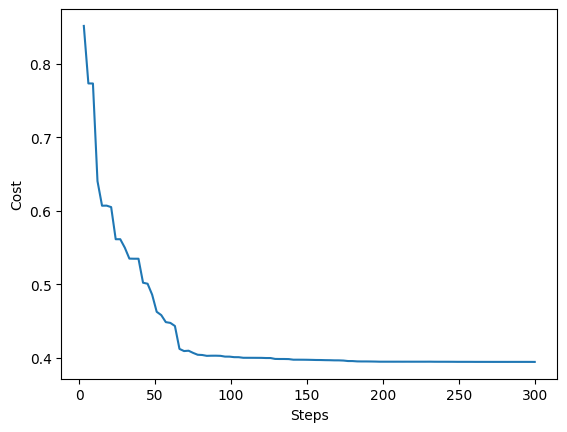

In [19]:
fig = plt.figure()
plt.plot(log.evaluations, log.costs)
plt.xlabel('Steps')
plt.ylabel('Cost')
plt.show()

Third, we test the trained classifier on the test data.

In [20]:
# score == accuracy
vqc.score(TEST_DATA, test_labels_oh)

0.9

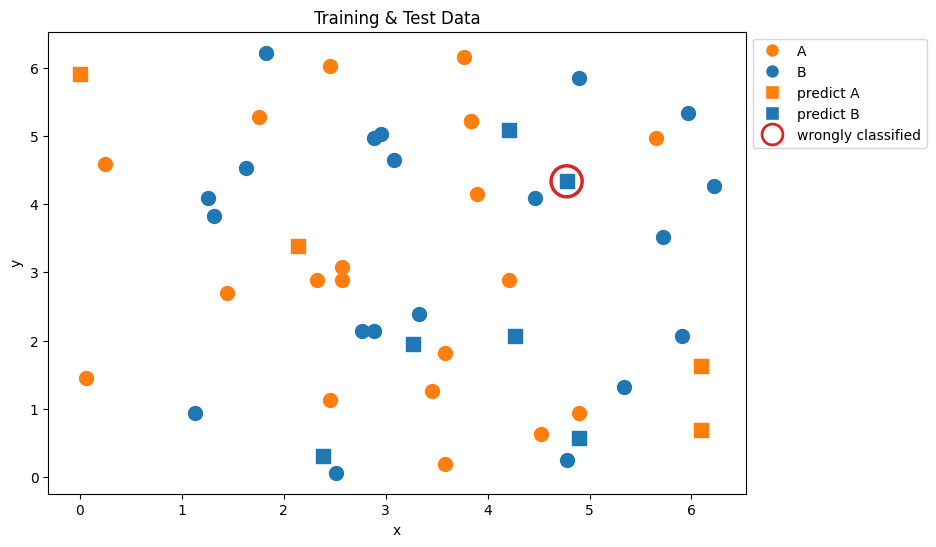

In [21]:
from matplotlib.lines import Line2D
plt.figure(figsize=(9, 6))

for feature, label in zip(TRAIN_DATA, train_labels_oh):
    COLOR = 'C1' if label[0] == 0 else 'C0'
    plt.scatter(feature[0], feature[1], marker='o', s=100,
                color=COLOR)

for feature, label, pred in zip(TEST_DATA, test_labels_oh,
                                vqc.predict(TEST_DATA)):
    COLOR = 'C1' if pred[0] == 0 else 'C0'
    plt.scatter(feature[0], feature[1], marker='s', s=100, color=COLOR)
    if not np.array_equal(label,pred):  # mark wrongly classified
        plt.scatter(feature[0], feature[1], marker='o', s=500,
                    linewidths=2.5, facecolor='none', edgecolor='C3')

legend_elements = [
    Line2D([0], [0], marker='o', c='w', mfc='C1', label='A', ms=10),
    Line2D([0], [0], marker='o', c='w', mfc='C0', label='B', ms=10),
    Line2D([0], [0], marker='s', c='w', mfc='C1', label='predict A',
           ms=10),
    Line2D([0], [0], marker='s', c='w', mfc='C0', label='predict B',
           ms=10),
    Line2D([0], [0], marker='o', c='w', mfc='none', mec='C3',
           label='wrongly classified', mew=2, ms=15)
]

plt.legend(handles=legend_elements, bbox_to_anchor=(1, 1),
           loc='upper left')

plt.title('Training & Test Data')
plt.xlabel('x')
plt.ylabel('y')
plt.show()

We see that the performance of the trained classifier is pretty good on the test data. The training optimization probably found the global minimum.

## Variational training

As with all variational algorithms, finding the optimal parameters of the variational circuit takes most of the processing time, and is dependent on the optimization method used, as discussed in the [training page](./training-quantum-circuits).

![](images/vqc/va.svg)

Our optimal circuit parameters, $\vec{\theta}^*$ are found when we find the minimum of the loss function, $f(\vec{\theta})$. However, there isn't a simple relationship between the loss function and the circuit parameters.

As a result, the loss landscape can be complicated, as shown in the hills and valleys of the example below. The optimization method navigates us around the loss landscape, searching for the minimum, as shown by the black points and lines. We observe that two-thirds of the searches end up in a local landscape minimum, rather than a global one. 

![](images/vqc/loss-landscape.png)

Generally the optimization methods can be categorised into two groups: gradient-based and gradient-free methods. To determine an optimal solution, gradient-based methods identify an extreme point at which the gradient is equal to zero. A search direction is selected and the searching direction is determined by the derivative of the loss function. The main disadvantages of this type of optimization are the convergence speed can be very slow and there is no guarantee to achieve the optimal solution. 

When derivative information is unavailable or impractical to obtain (e.g. when the loss function is expensive to evaluate or somewhat noisy), gradient-free methods can be very useful. Such optimisation techniques are robust to find the global optima, while the gradient-based methods tend to converge into local optima. However, gradient-free methods require higher computational capacities, especially for the problems with high-dimensional search spaces.

![](images/vqc/barren-plateaus.png)

Despite what type of optimization method is used, if the loss landscape is fairly flat, it can be difficult for the method to determine which direction to search. This situation is called a _[barren plateau](gloss:barren-plateaus),_ and was studied in Reference 4. For a wide class of reasonable parameterized quantum circuits, the probability that the gradient along any reasonable direction is non-zero to some fixed precision is exponentially small as a function of the number of qubits.

One approach to overcome this problem is to use structured initial guesses, such as those adopted in quantum simulation. Another possibility is to consider the full quantum circuit as a sequence of shallow blocks, selecting some parameters randomly and choosing the rest of the parameters such that all shallow blocks implement the identity to restrict the effective depth. This is an area of current investigation.

## References

1. Alberto Peruzzo, Jarrod McClean, Peter Shadbolt, Man-Hong Yung, Xiao-Qi Zhou, Peter J. Love, Alán Aspuru-Guzik and Jeremy L. O'Brien, *A variational eigenvalue solver on a quantum processor*, Nature Communications, 5:4213 (2014), [doi.org:10.1038/ncomms5213](https://doi.org/10.1038/ncomms5213), [arXiv:1304.3061](https://arxiv.org/abs/1304.3061).
1. Edward Farhi, Jeffrey Goldstone and Sam Gutmann, *A Quantum Approximate Optimization Algorithm* (2014), [arXiv:1411.4028](https://arxiv.org/abs/1411.4028).
1. Vojtech Havlicek, Antonio D. Córcoles, Kristan Temme, Aram W. Harrow, Abhinav  Kandala, Jerry M. Chow and Jay M. Gambetta, *Supervised learning with quantum enhanced feature spaces*, Nature 567, 209-212 (2019), [doi.org:10.1038/s41586-019-0980-2](https://doi.org/10.1038/s41586-019-0980-2), [arXiv:1804.11326](https://arxiv.org/abs/1804.11326).
1. Jarrod R. McClean, Sergio Boixo, Vadim N. Smelyanskiy, Ryan Babbush and Hartmut Neven, *Barren plateaus in quantum neural network training landscapes*, Nature Communications volume 9, Article number: 4812 (2018), [doi.org:10.1038/s41467-018-07090-4](https://www.nature.com/articles/s41467-018-07090-4) [arXiv:1803.1117](https://arxiv.org/abs/1803.11173).

In [22]:
# pylint: disable=unused-import
import qiskit.tools.jupyter
%qiskit_version_table